### ``TORCHVISION.TRANSFORMS``
Transforms are common image transformations. They can be chained together using Compose. Additionally, there is the ``torchvision.transforms.functional`` module. Functional transforms give fine-grained control over the transformations. This is useful if you have to build a more complex transformation pipeline (e.g. in the case of segmentation tasks).

In [6]:
import torch
from torchvision import transforms
from PIL import Image
torch.manual_seed(42)

In [45]:
dog = Image.open('dog.jpg')

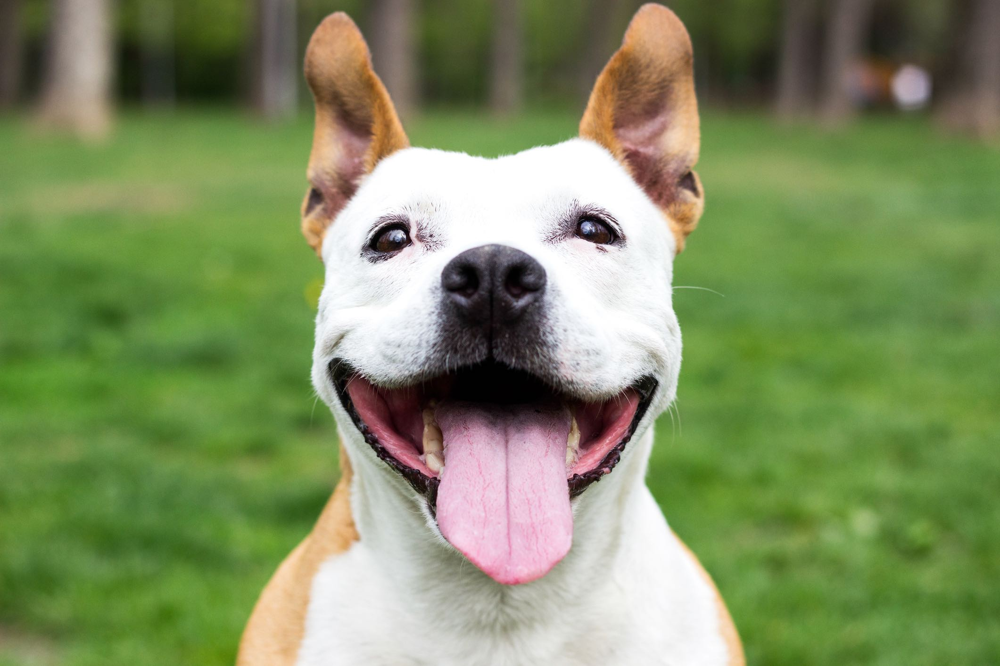

In [5]:
dog

### ``Scriptable transforms``
In order to script the transformations, please use `torch.nn.Sequential` instead of `Compose`.

```python
transforms = torch.nn.Sequential(
    transforms.CenterCrop(10),
    transforms.Normalize((0.485, 0.456, 0.406), (0.229, 0.224, 0.225)),
)
scripted_transforms = torch.jit.script(transforms)
```

### `Compositions of transforms`
The `torchvision.transforms.Compose` takes a list of transforms that you want to apply on an image for example:
    
```python
composed = Compose([
    ToTensor(),
    transforms.CenterCrop(10),
    ...
])
```

### `torchvision.transforms.CenterCrop(size)`
* Crops the given image at the center.
* Returns `PIL` image or `Tensor`

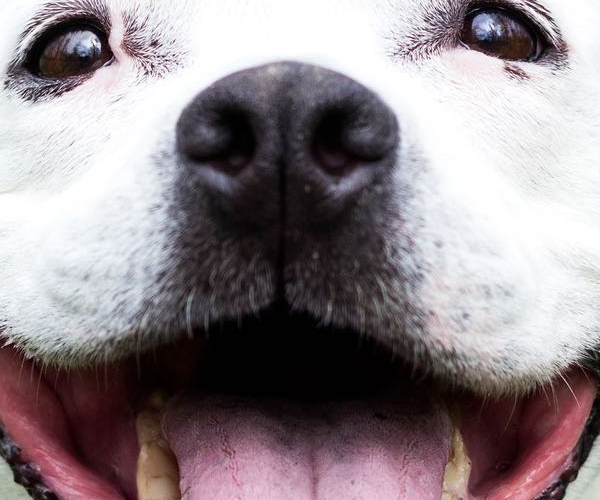

In [17]:
process = transforms.CenterCrop([500, 600])
cropped_dog = process(dog)
cropped_dog

### ``torchvision.transforms.ColorJitter(brightness=0, contrast=0, saturation=0, hue=0)``
Randomly change the brightness, contrast, saturation and hue of an image. 

### `torchvision.transforms.FiveCrop(size)`
* Crop the given image into four corners and the central crop. 

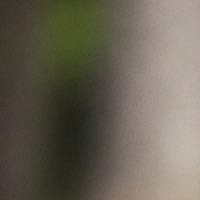

In [25]:
process = transforms.FiveCrop(200)
dog_five_crop = process(dog)
dog_five_crop,
dog_five_crop[0]

### `torchvision.transforms.Grayscale(num_output_channels=1)`
* Convert image to grayscale.

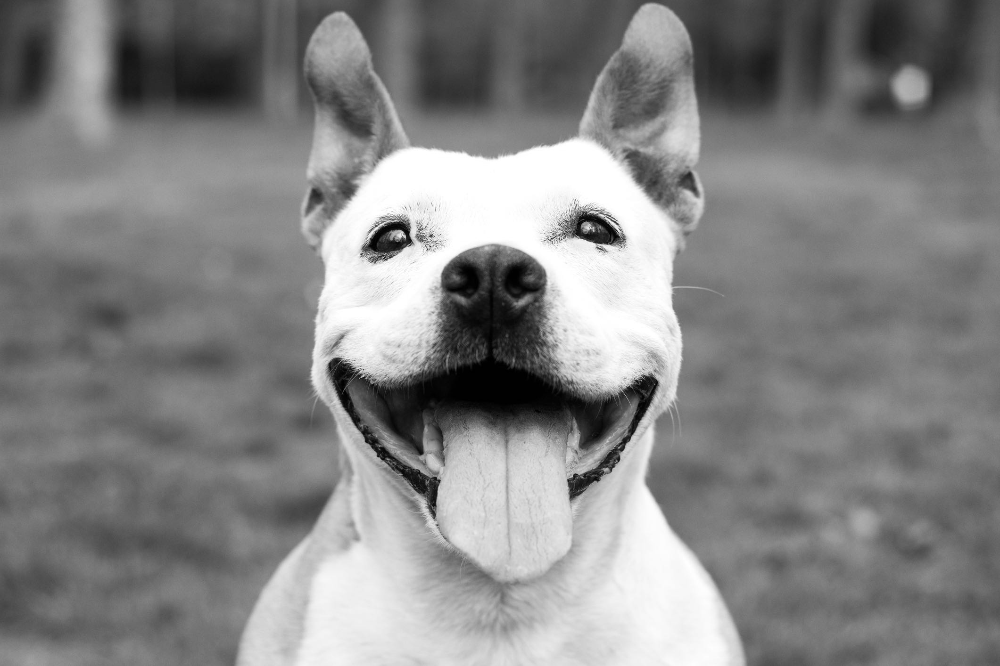

In [27]:
process = transforms.Grayscale(3)
gray_dog = process(dog)
gray_dog 

### `torchvision.transforms.Pad(padding, fill=0, padding_mode='constant')`
* pad the given image on all sides with the given “pad” value.

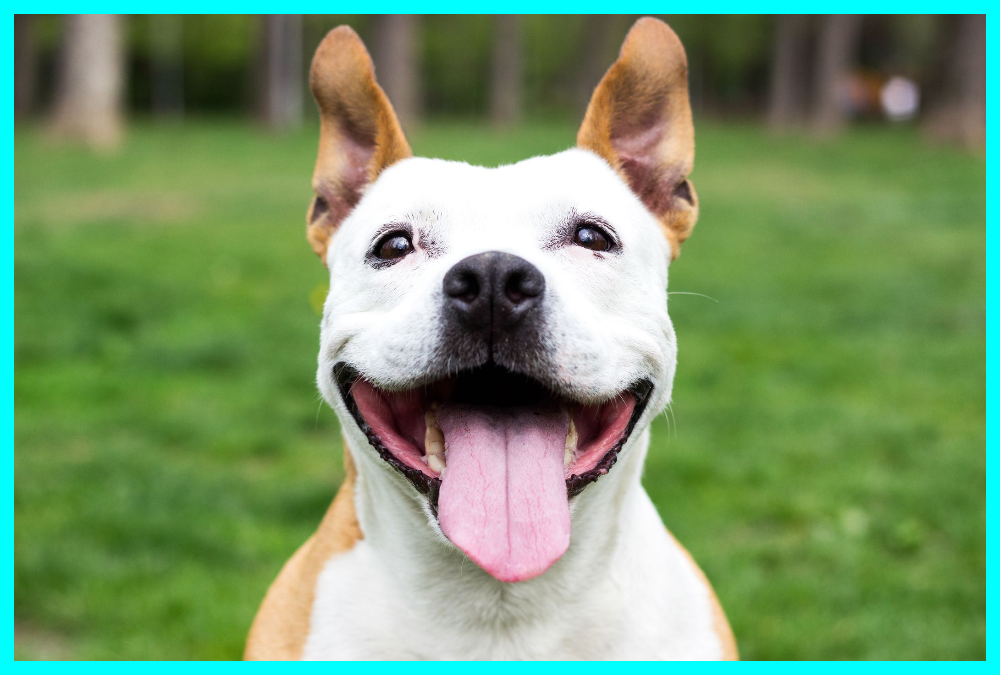

In [30]:
process = transforms.Pad(30, fill=(0, 255, 255))
pad_dog = process(dog)
pad_dog 

### `torchvision.transforms.RandomAffine(degrees, translate=None, scale=None, shear=None, interpolation=<InterpolationMode.NEAREST: 'nearest'>, fill=0, fillcolor=None, resample=None)`
* Random affine transformation of the image keeping center invariant.

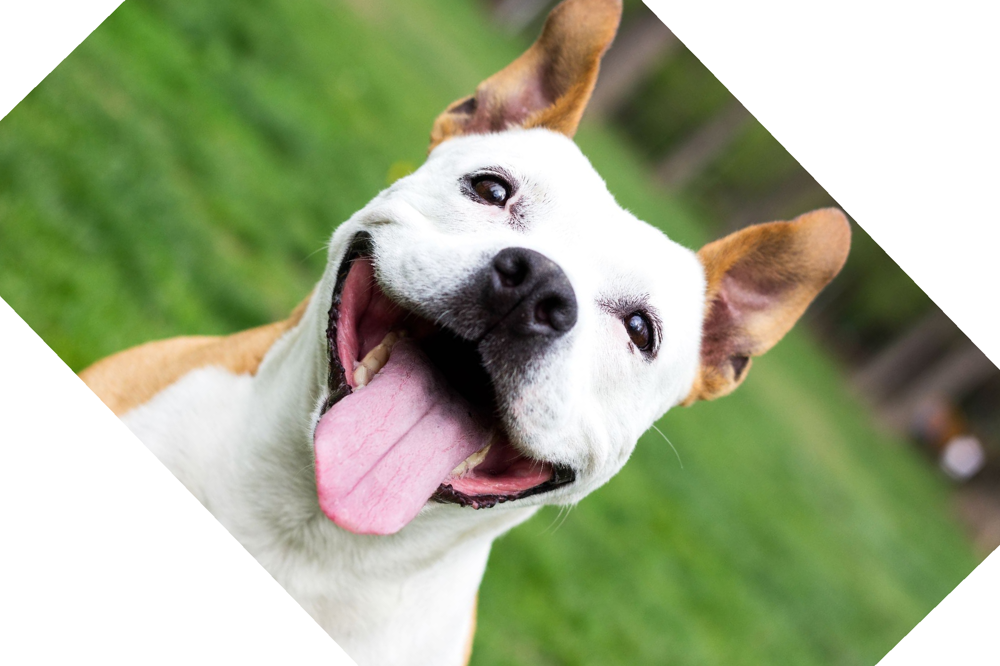

In [34]:
process = transforms.RandomAffine(50, fill=255)
affine_dog = process(dog)
affine_dog 

### ``torchvision.transforms.RandomCrop(size, padding=None, pad_if_needed=False, fill=0, padding_mode='constant')``
* Crop the given image at a random locatio

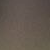

In [35]:
process = transforms.RandomCrop(50)
processed_dog = process(dog)
processed_dog 

### `torchvision.transforms.RandomGrayscale(p=0.1)`
* Randomly convert image to grayscale with a probability of p (default 0.1). 


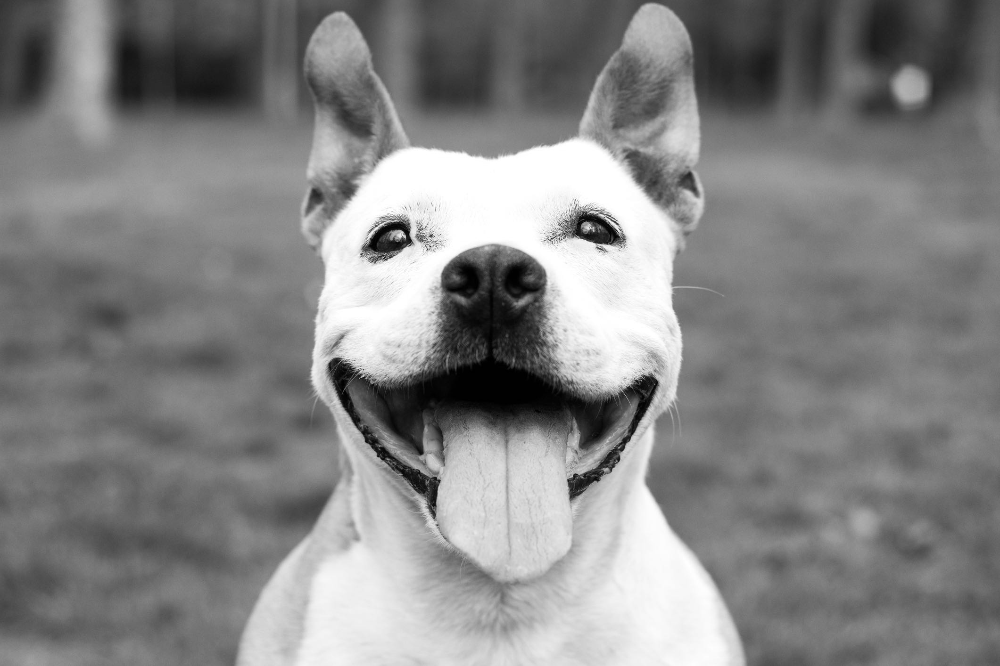

In [36]:
process = transforms.transforms.RandomGrayscale(50)
processed_dog = process(dog)
processed_dog 

### `torchvision.transforms.RandomHorizontalFlip(p=0.5)`
* Horizontally flip the given image randomly with a given probability. 

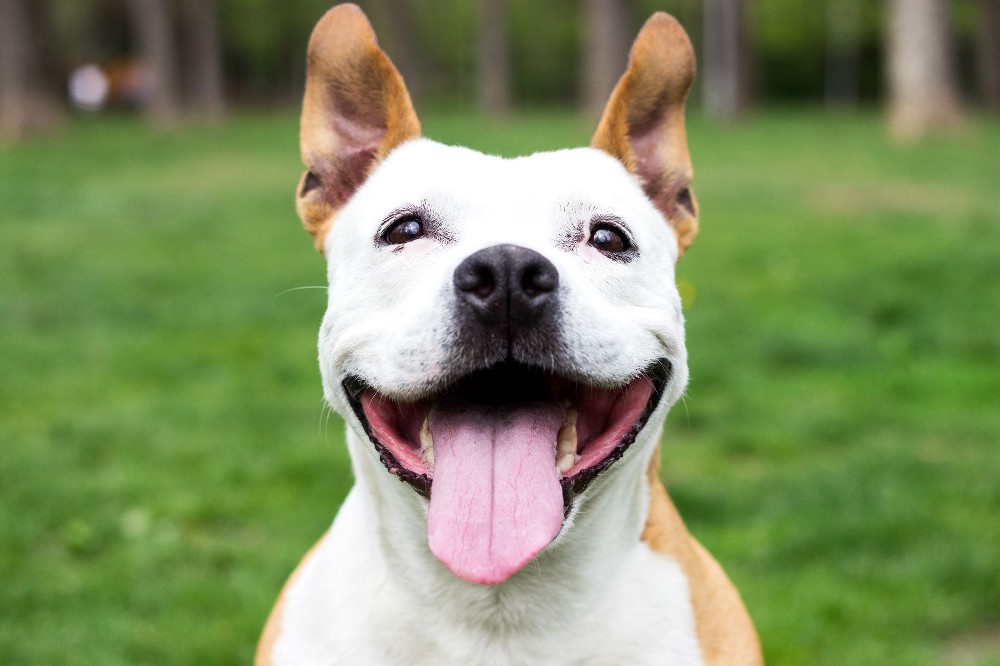

In [37]:
process = transforms.transforms.RandomHorizontalFlip(50)
processed_dog = process(dog)
processed_dog 

### `torchvision.transforms.RandomPerspective(distortion_scale=0.5, p=0.5, interpolation=<InterpolationMode.BILINEAR: 'bilinear'>, fill=0)`
* Performs a random perspective transformation of the given image with a given probability.

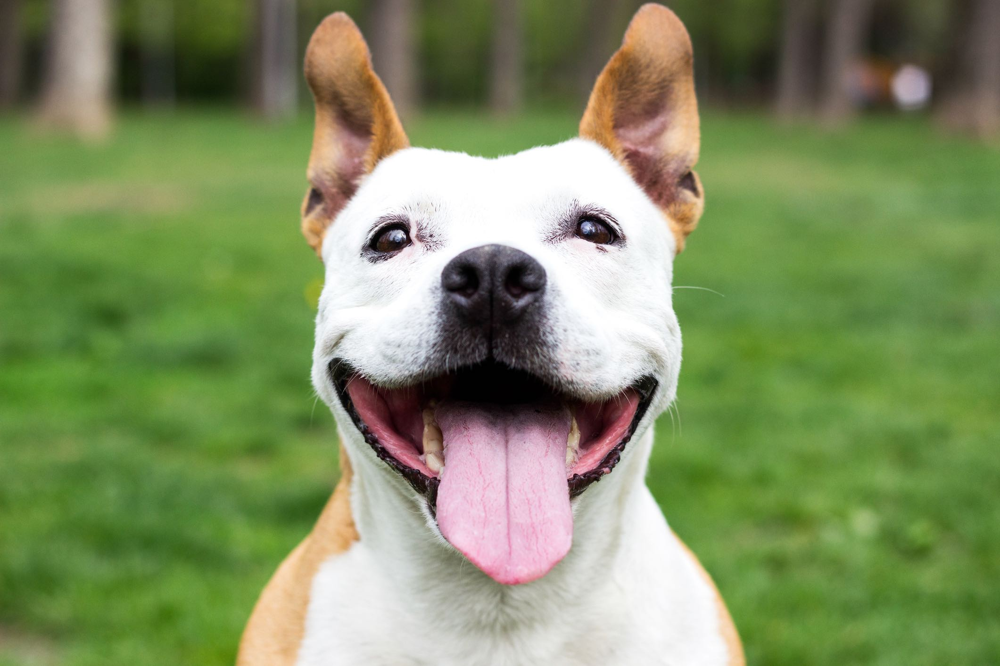

In [39]:
process = transforms.transforms.RandomPerspective(.50)
processed_dog = process(dog)
processed_dog 

### `torchvision.transforms.RandomRotation(degrees, interpolation=<InterpolationMode.NEAREST: 'nearest'>, expand=False, center=None, fill=0, resample=None)`
* Rotate the image by angle. 

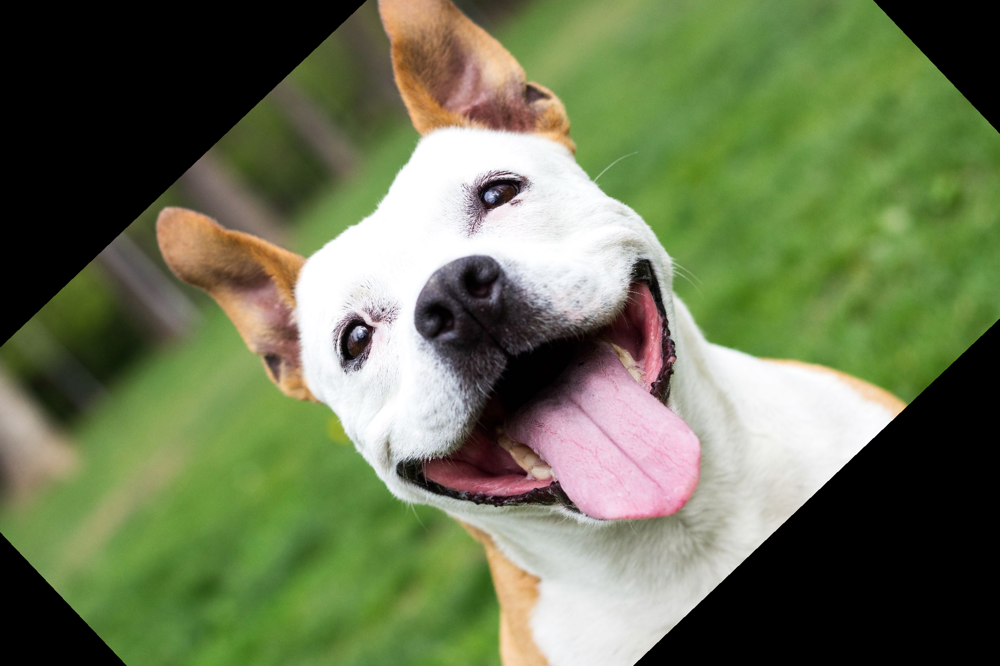

In [41]:
process = transforms.transforms.RandomRotation(50)
processed_dog = process(dog)
processed_dog 

### `torchvision.transforms.Resize(size, interpolation=<InterpolationMode.BILINEAR: 'bilinear'>)`
* Resize the input image to the given size. 


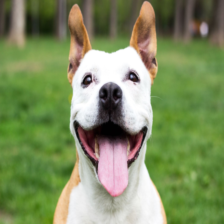

In [46]:
process = transforms.transforms.Resize([224, 224])
dog = process(dog)
dog 

### ``torchvision.transforms.GaussianBlur(kernel_size, sigma=(0.1, 2.0))``
* Blurs image with randomly chosen Gaussian blur. 

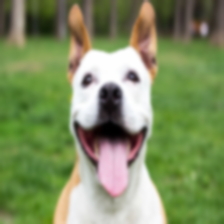

In [52]:
process = transforms.transforms.GaussianBlur((7, 7)) # kernel_size should be odd numbers
processed_dog = process(dog)
processed_dog 

### `transforms.ToTensor()`
* Transforms a PIL image to a pytorch tensor.

In [54]:
dog_tensor = transforms.ToTensor()(dog)
dog_tensor

tensor([[[0.2353, 0.2392, 0.2510,  ..., 0.3255, 0.3412, 0.3490],
         [0.2314, 0.2431, 0.2588,  ..., 0.3294, 0.3451, 0.3490],
         [0.2353, 0.2510, 0.2667,  ..., 0.3373, 0.3490, 0.3529],
         ...,
         [0.4980, 0.5020, 0.5176,  ..., 0.2745, 0.2627, 0.2588],
         [0.4745, 0.4745, 0.4902,  ..., 0.2706, 0.2549, 0.2510],
         [0.4588, 0.4627, 0.4745,  ..., 0.2824, 0.2588, 0.2510]],

        [[0.2078, 0.2118, 0.2275,  ..., 0.2824, 0.2980, 0.3059],
         [0.2039, 0.2157, 0.2314,  ..., 0.2902, 0.3020, 0.3059],
         [0.2078, 0.2235, 0.2392,  ..., 0.2941, 0.3059, 0.3098],
         ...,
         [0.5922, 0.5922, 0.6000,  ..., 0.4275, 0.4196, 0.4275],
         [0.5961, 0.5922, 0.6000,  ..., 0.4235, 0.4118, 0.4157],
         [0.5922, 0.5961, 0.6000,  ..., 0.4314, 0.4196, 0.4196]],

        [[0.1686, 0.1725, 0.1804,  ..., 0.2745, 0.2902, 0.2980],
         [0.1647, 0.1765, 0.1882,  ..., 0.2824, 0.2941, 0.2980],
         [0.1686, 0.1843, 0.1922,  ..., 0.2863, 0.2980, 0.

### ``torchvision.transforms.Normalize(mean, std, inplace=False)``
* Normalize a tensor image with mean and standard deviation.

In [57]:
process = transforms.Normalize(
       mean=[0.485, 0.456, 0.406],
       std=[0.229, 0.224, 0.225]
   )
processed_dog = process(dog_tensor)
processed_dog 

tensor([[[-1.0904, -1.0733, -1.0219,  ..., -0.6965, -0.6281, -0.5938],
         [-1.1075, -1.0562, -0.9877,  ..., -0.6794, -0.6109, -0.5938],
         [-1.0904, -1.0219, -0.9534,  ..., -0.6452, -0.5938, -0.5767],
         ...,
         [ 0.0569,  0.0741,  0.1426,  ..., -0.9192, -0.9705, -0.9877],
         [-0.0458, -0.0458,  0.0227,  ..., -0.9363, -1.0048, -1.0219],
         [-0.1143, -0.0972, -0.0458,  ..., -0.8849, -0.9877, -1.0219]],

        [[-1.1078, -1.0903, -1.0203,  ..., -0.7752, -0.7052, -0.6702],
         [-1.1253, -1.0728, -1.0028,  ..., -0.7402, -0.6877, -0.6702],
         [-1.1078, -1.0378, -0.9678,  ..., -0.7227, -0.6702, -0.6527],
         ...,
         [ 0.6078,  0.6078,  0.6429,  ..., -0.1275, -0.1625, -0.1275],
         [ 0.6254,  0.6078,  0.6429,  ..., -0.1450, -0.1975, -0.1800],
         [ 0.6078,  0.6254,  0.6429,  ..., -0.1099, -0.1625, -0.1625]],

        [[-1.0550, -1.0376, -1.0027,  ..., -0.5844, -0.5147, -0.4798],
         [-1.0724, -1.0201, -0.9678,  ..., -0

In [ ]:
### `torchvision.transforms.ToPILImage(mode=None)`
* Convert a tensor or an ndarray to PIL Image. 

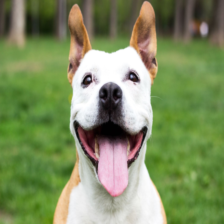

In [69]:
process = transforms.ToPILImage()
processed_dog = process(dog_tensor)
processed_dog 

### `torchvision.transforms.RandomErasing(p=0.5, scale=(0.02, 0.33), ratio=(0.3, 3.3), value=0, inplace=False)`
*Randomly selects a rectangle region in an torch Tensor image and erases its pixels.

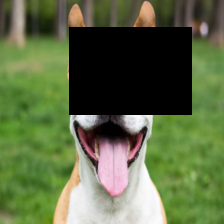

In [70]:
process = transforms.Compose([
    transforms.RandomErasing(),
    transforms.ToPILImage()
])
processed_dog = process(dog_tensor)
processed_dog 

> [Docs](https://pytorch.org/vision/stable/transforms.html)